In [1]:
# starting point: take "../transition-to-flux/second-refactor" setup and try to run ADAM on it

┌ Warning: This version of CUDA.jl only supports NVIDIA drivers for CUDA 10.1 or higher (yours is for CUDA 9.1.0)
└ @ CUDA C:\Users\Fluid3\.julia\packages\CUDA\M4jkK\src\initialization.jl:100


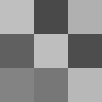

In [2]:
using Flux
import TestImages: testimage
import ImageView: imshow
import Images: Gray
img = testimage("mandrill")
im0 = 1*Gray.(img)
import ImageTransformations: imresize
im3 = imresize(im0, 3, 3)

In [3]:
# we are going to do the same or similar ops for a small matrix and for a large one
# and this way if any problems arise, we'll know if it's logic or size
m_im0 = convert(Matrix{Float32}, im0)
m_im3 = convert(Matrix{Float32}, im3)

3×3 Matrix{Float32}:
 0.749673  0.286601  0.689869
 0.378105  0.743137  0.302288
 0.515142  0.466993  0.72146

In [4]:
function warp3(x, y, p) # 0:31
    knob = p[:knob]
    clip(n, nsize) = max(min(nsize, n), 1)
    (xnew, ynew) =
        # clip(convert(Int, floor(x - 10 * (knob / 32) * sin(y/4))), xsize), y), # currently unused variant
        # clip(convert(Int, floor(x + 10 * ((knob - 16) / 16) * sin(y/4))), xsize), y) # normalize to get +/-
        (clip(x + 10 * ((knob - 16) / 16) * sin(y/4), p[:xsize]), y)
    xnew, ynew
end

warp3 (generic function with 1 method)

In [5]:
function apply_warp(warp, im, p)
    (xsize, ysize) = size(im)
    p[:xsize] = xsize
    p[:ysize] = ysize
    function linear_interpolation(x_y)
        # a rough draft, this can be improved; works on im
        x = x_y[1]
        y = x_y[2]
        dx=mod(x,1)
        dy=mod(y,1)
        x_left = floor(Int,x)
        y_left = floor(Int,y)
        x_right = min(x_left + 1, xsize)
        y_right = min(y_left + 1, ysize)
        im[x_left,y_left]*(1-dx)*(1-dy) + im[x_left,y_right]*(1-dx)*dy + im[x_right,y_left]*dx*(1-dy) + im[x_right, y_right]*dx*dy
    end
    [linear_interpolation(warp(x,y,p)) for x in 1:xsize, y in 1:ysize]
end

apply_warp (generic function with 1 method)

In [6]:
pars = Dict(:knob=>0, :dummy=>0.0)
# at least one of the above should be float and not integer, so that the dictionary type is
# Dict{Symbol, Real}  and not Dict{Symbol, Int64}

Dict{Symbol, Real} with 2 entries:
  :dummy => 0.0
  :knob  => 0

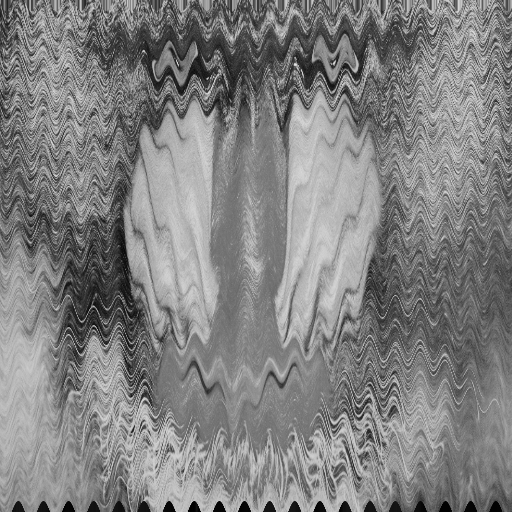

In [7]:
m_im0_warped = apply_warp(warp3, m_im0, pars)
Gray.(m_im0_warped)

In [8]:
# scale image so that all points brightness are between 0 and 1, and that full range is used
# we are going to use this on plain matrices and not on images, so this code changed at second-refactor
function normalize_image(im)
    im_res = im .- minimum(im)
    return (1/maximum(im_res))*im_res
end

normalize_image (generic function with 1 method)

In [9]:
import LinearAlgebra: transpose

In [10]:
norm_columns(f, x) = f.(x) ./ (sum(f.(x), dims=1))

norm_columns (generic function with 1 method)

In [11]:
# this version returns an ordinary matrix, does not try to produce an image
# this is introduced in second-refactor
norm_image_columns(f, x) = normalize_image(norm_columns(f, x))

norm_image_columns (generic function with 1 method)

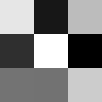

In [12]:
m_im3_norm = norm_image_columns(x -> x+1, m_im3)
Gray.(m_im3_norm)

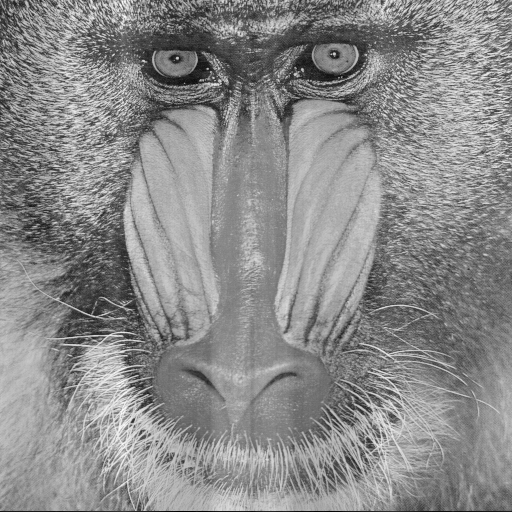

In [13]:
m_im0_norm = norm_image_columns(x -> x+1, m_im0)
Gray.(m_im0_norm)

In [14]:
transposed_product(x) = normalize_image(transpose(x)*x)

transposed_product (generic function with 1 method)

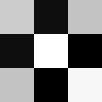

In [15]:
p_m_im3_norm = transposed_product(m_im3_norm)
Gray.(p_m_im3_norm)

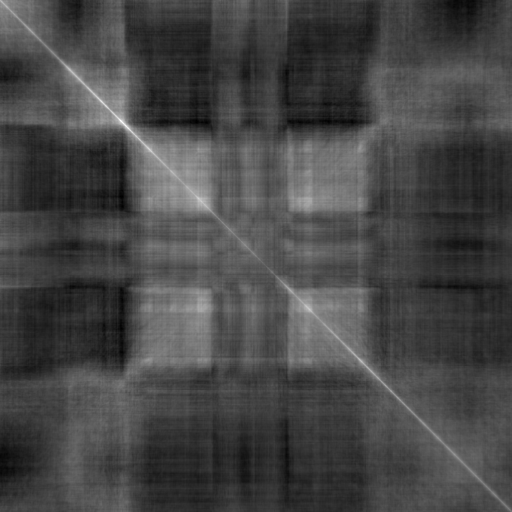

In [16]:
p_m_im0_norm = transposed_product(m_im0_norm)
Gray.(p_m_im0_norm)

In [17]:
m_im3_warped = deepcopy(m_im3)

3×3 Matrix{Float32}:
 0.749673  0.286601  0.689869
 0.378105  0.743137  0.302288
 0.515142  0.466993  0.72146

In [18]:
m_im3_warped[1,2] = m_im3_warped[2,2]
m_im3_warped[2,2] = m_im3_warped[3,2]
m_im3_warped[3,2] = 0

0

In [19]:
m_im3_warped

3×3 Matrix{Float32}:
 0.749673  0.743137  0.689869
 0.378105  0.466993  0.302288
 0.515142  0.0       0.72146

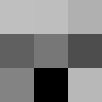

In [20]:
Gray.(m_im3_warped)

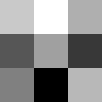

In [21]:
m_im3_warped_norm = norm_image_columns(x -> x+1, m_im3_warped)
Gray.(m_im3_warped_norm)

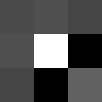

In [22]:
p_m_im3_warped_norm = transposed_product(m_im3_warped_norm)
Gray.(p_m_im3_warped_norm)

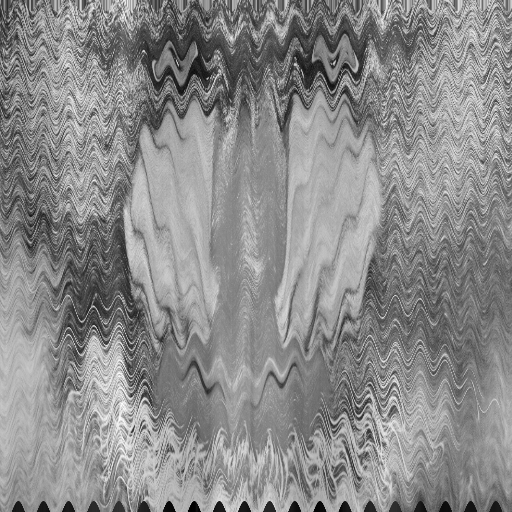

In [23]:
m_im0_warped_norm = norm_image_columns(x -> x+1, m_im0_warped)
Gray.(m_im0_warped_norm)

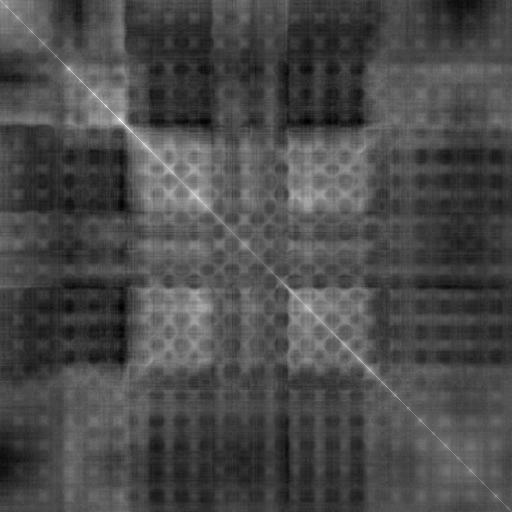

In [24]:
p_m_im0_warped_norm = transposed_product(m_im0_warped_norm)
Gray.(p_m_im0_warped_norm)

In [25]:
import LinearAlgebra: norm

In [26]:
value3(A) = transposed_product(norm_image_columns(x -> x+1, A))

value3 (generic function with 1 method)

In [27]:
loss(x, y) = norm(value3(x) - y)

loss (generic function with 1 method)

In [28]:
loss_small = loss(m_im3, p_m_im3_warped_norm)

1.1058546f0

In [29]:
loss_small * loss_small

1.2229145f0

In [30]:
loss_small^2

1.2229145f0

In [31]:
import LinearAlgebra: dot

In [32]:
loss2(x, y) = dot(value3(x) - y, value3(x) - y)

loss2 (generic function with 1 method)

In [33]:
loss2(m_im3, p_m_im3_warped_norm)

1.2229145f0

In [34]:
opt = ADAM()

ADAM(0.001, (0.9, 0.999), IdDict{Any, Any}())

In [35]:
# I think I want a custom-made training loop instead of train! from
# https://github.com/FluxML/Flux.jl/blob/master/src/optimise/train.jl

In [36]:
small_ms = []

Any[]

In [37]:
import Flux.Optimise: update!

In [38]:
function step!(x, y, loss, opt, accum)
    p = params(x)
    push!(accum, deepcopy(x)) # I am unhappy about the loss of intermediate parameter values
    grads = gradient(()->loss(x, y), p)
    update!(opt, p, grads)
    loss(x, y)
end

step! (generic function with 1 method)

In [39]:
m_im3_copy = deepcopy(m_im3)

3×3 Matrix{Float32}:
 0.749673  0.286601  0.689869
 0.378105  0.743137  0.302288
 0.515142  0.466993  0.72146

In [49]:
loss(m_im3, p_m_im3_warped_norm)

1.1058546f0

In [40]:
step!(m_im3, p_m_im3_warped_norm, loss, opt, small_ms)

1.0901217f0

In [41]:
loss(m_im3, p_m_im3_warped_norm)

1.0901217f0

In [673]:
# let's click a few time
step!(m_im3, p_m_im3_warped_norm, loss, opt, small_ms)

0.0009998509f0

In [674]:
length(small_ms)

628

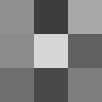

In [675]:
Gray.(m_im3)

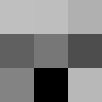

In [676]:
Gray.(m_im3_warped)

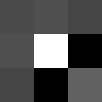

In [677]:
Gray.(value3(m_im3))

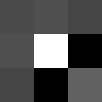

In [678]:
Gray.(p_m_im3_warped_norm)

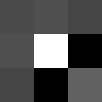

In [679]:
Gray.(value3(m_im3_warped))

In [380]:
# it seems likely that this one does converge to a global minimum, and that this global minimum is not unique

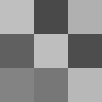

In [680]:
Gray.(small_ms[1])

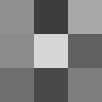

In [681]:
Gray.(small_ms[628])

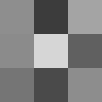

In [682]:
Gray.(small_ms[314])

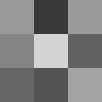

In [683]:
Gray.(small_ms[157])

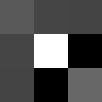

In [685]:
Gray.(value3(small_ms[157]))

In [686]:
large_ms = [] # of course, our idea to store all intermediate matrices is highly questionable, we'll adjust this

Any[]

In [687]:
opt2 = ADAM() # the easiest way to surely reset the optimizer is to create another copy

ADAM(0.001, (0.9, 0.999), IdDict{Any, Any}())

In [688]:
m_im0_copy = deepcopy(m_im0)

512×512 Matrix{Float32}:
 0.568627   0.219608   0.192157   0.34902   …  0.443137  0.6        0.694118
 0.454902   0.396078   0.156863   0.262745     0.509804  0.584314   0.490196
 0.301961   0.447059   0.180392   0.180392     0.392157  0.345098   0.317647
 0.278431   0.533333   0.372549   0.188235     0.286275  0.294118   0.27451
 0.341176   0.478431   0.517647   0.196078     0.231373  0.313726   0.337255
 0.321569   0.298039   0.623529   0.239216  …  0.333333  0.596078   0.713726
 0.168627   0.2        0.52549    0.509804     0.72549   0.776471   0.643137
 0.129412   0.2        0.435294   0.6          0.631373  0.470588   0.541176
 0.223529   0.188235   0.219608   0.458824     0.529412  0.611765   0.478431
 0.14902    0.12549    0.188235   0.25098      0.254902  0.317647   0.533333
 0.129412   0.168627   0.223529   0.145098  …  0.254902  0.286275   0.266667
 0.129412   0.184314   0.305882   0.141176     0.34902   0.290196   0.294118
 0.141176   0.262745   0.352941   0.254902     0.301

In [689]:
loss(m_im0, p_m_im0_warped_norm)

20.39865222030749

In [690]:
step!(m_im0, p_m_im0_warped_norm, loss, opt2, large_ms)

18.9305199942761

In [691]:
loss(m_im0, p_m_im0_warped_norm)

18.9305199942761

In [934]:
# let's click a few times
step!(m_im0, p_m_im0_warped_norm, loss, opt2, large_ms)

1.111619282630947

In [935]:
length(large_ms)

227

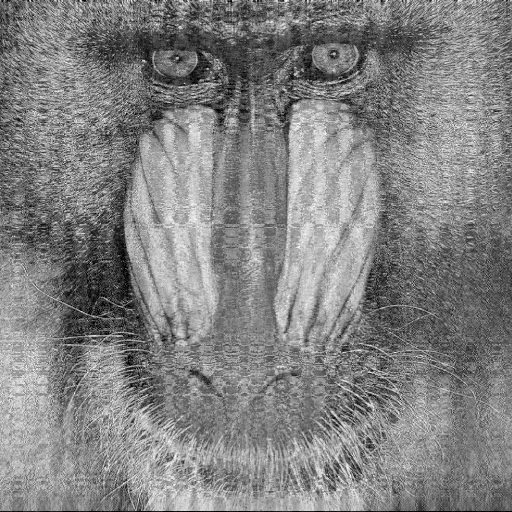

In [936]:
Gray.(m_im0)

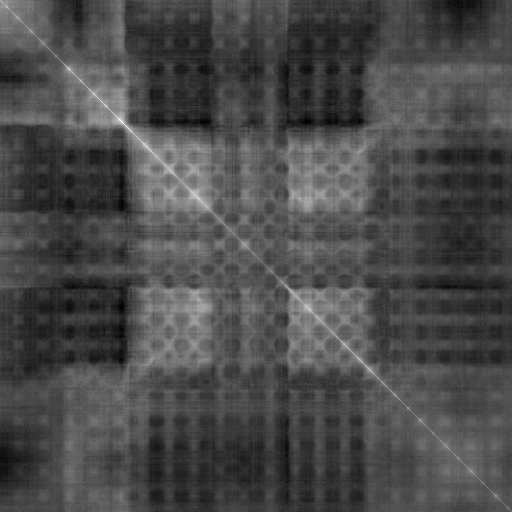

In [937]:
Gray.(value3(m_im0))

In [938]:
# ADAM converges confidently approximately up-to-here
# Of course, visually it reached the solution long ago
# (and the convergence might resume)

# We again see that this task has multiple solutions/multiple global minuma

# I am pretty happy about the achieved result (it turned out that a smaller, 
# milder change than "warp3" yields comparable effects in the "value3" appearance)

In [939]:
length(large_ms)

227

,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,

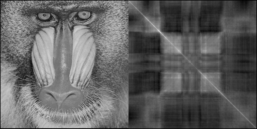
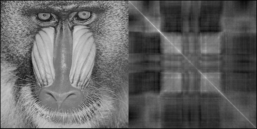
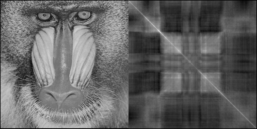
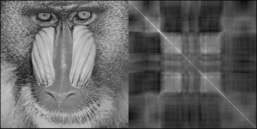
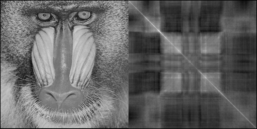
...
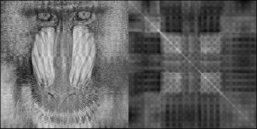
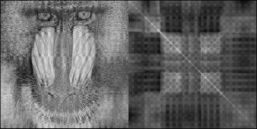
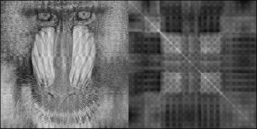
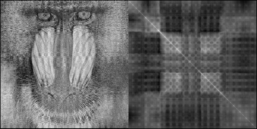
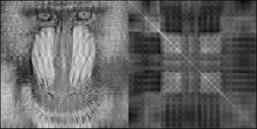

In [942]:
animation_frames = [Gray.(hcat(large_ms[i], value3(large_ms[i]))) for i in 1:length(large_ms)] 

In [943]:
length(animation_frames)

227

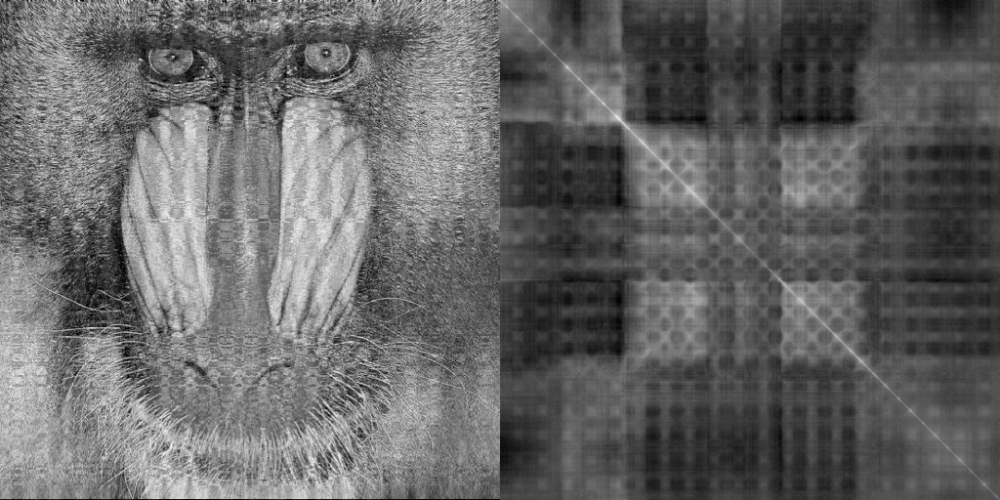

In [957]:
animation_frames[200]

In [962]:
convert(Float32, maximum(animation_frames[227]))

1.0125469f0

In [963]:
convert(Float32, minimum(animation_frames[227]))

-0.1082513f0

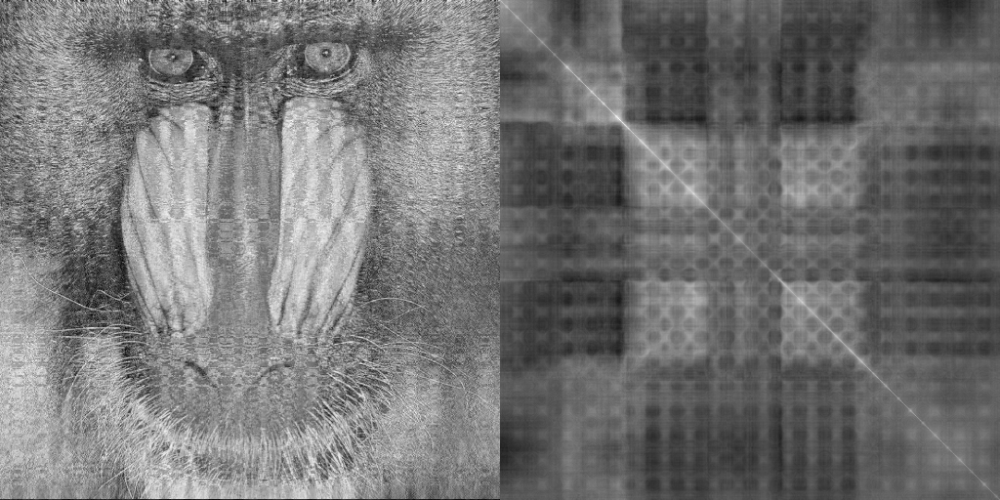

In [964]:
normalize_image(animation_frames[227])

In [966]:
clip_float(x) = max(min(x, 1), 0)

clip_float (generic function with 1 method)

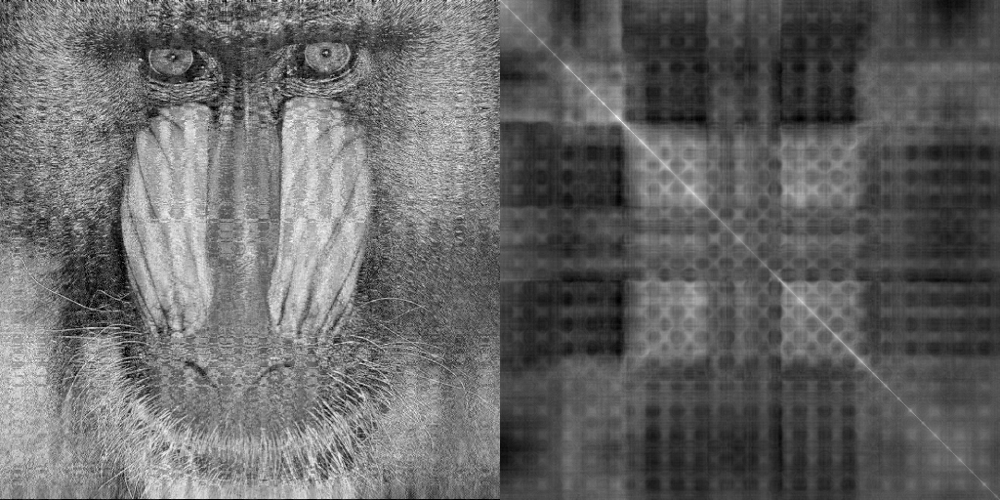

In [969]:
test_image = Gray.(clip_float.(animation_frames[227]))

In [972]:
convert(Float32, maximum(test_image))

1.0f0

In [974]:
convert(Float32, minimum(test_image))

0.0f0

In [979]:
using FileIO

full_imgs = []
for i in 1:6:length(animation_frames)
    push!(full_imgs, Gray.(clip_float.(animation_frames[i])))
end

save("learning-may-23_step6_fps1.gif", cat(full_imgs..., dims=3), fps=1)

In [980]:
xrange = 1:length(large_ms)
yrange = [loss(large_ms[i], p_m_im0_warped_norm) for i in xrange]

227-element Vector{Float64}:
 20.39865222030749
 18.9305199942761
 17.998569061401966
 17.49119733845732
 17.132584777867756
 16.851141536716476
 16.591936443820682
 16.3250989280025
 16.04205911311987
 15.753054766152719
 15.470893328457572
 15.20849605869153
 14.971499346699602
  ⋮
  1.2565603388106603
  1.2390896103307145
  1.2245854257870774
  1.2206360540555494
  1.2468107449401369
  1.280542601146494
  1.2042960635196653
  1.1326803211111955
  1.1688780252268172
  1.1692123519947941
  1.0896548820549496
  1.0963450846315603

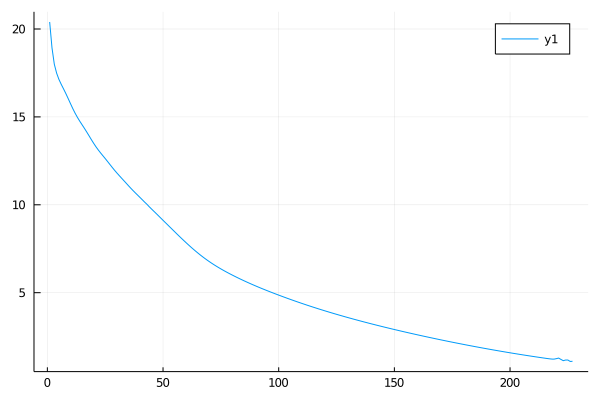

In [984]:
using Plots
plot(xrange, yrange)

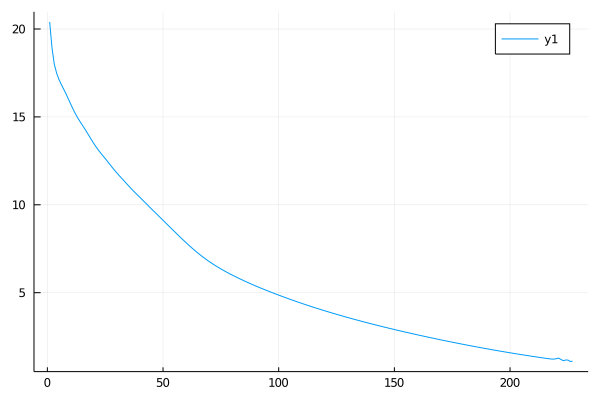

In [985]:
plot(xrange, yrange, fmt = :png)

In [986]:
img_play = deepcopy(m_im0)

512×512 Matrix{Float32}:
 0.564856   0.261535    0.056439     …  0.329288   0.713861    0.79111
 0.499647   0.313414   -0.000334003     0.483625   0.590751    0.536419
 0.366719   0.370888    0.289384        0.386241   0.371101    0.426697
 0.391571   0.476455    0.484095        0.407102   0.382287    0.385918
 0.344886   0.393207    0.513401        0.364966   0.476049    0.432699
 0.389016   0.392689    0.456217     …  0.298287   0.556424    0.654247
 0.337213   0.378375    0.465253        0.620427   0.604655    0.507662
 0.326038   0.337998    0.347073        0.515273   0.449752    0.481285
 0.421677   0.260315    0.316029        0.522783   0.689854    0.483008
 0.339133   0.285687    0.369455        0.335581   0.447747    0.623198
 0.29864    0.306953    0.254314     …  0.216122   0.432002    0.381806
 0.280554   0.281857    0.382168        0.401827   0.404648    0.366835
 0.208709   0.370663    0.488246        0.28154    0.424964    0.517827
 ⋮                                   ⋱  

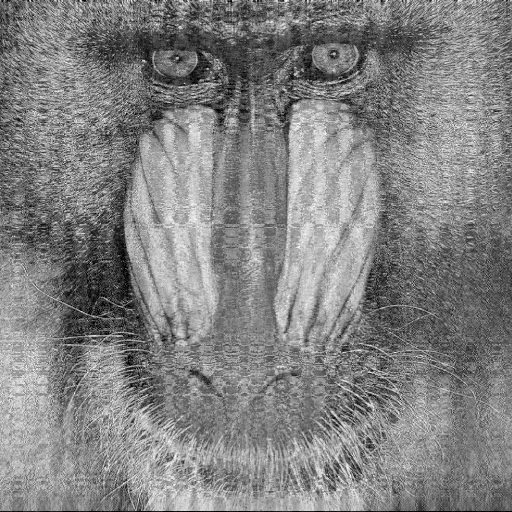

In [987]:
Gray.(img_play)

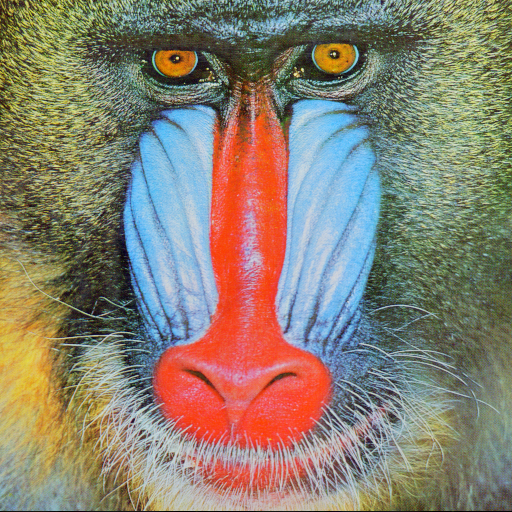

In [1013]:
color_512 = deepcopy(img)

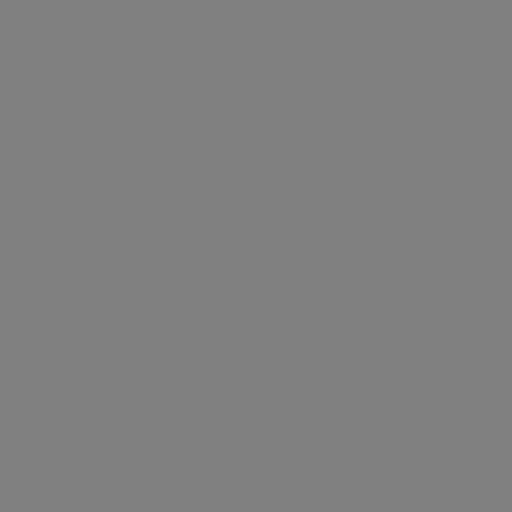

In [1014]:
color_512 .= 0.5

In [998]:
using ImageCore

In [1002]:
typeof(color_512)

Matrix{RGB{N0f8}} (alias for Array{RGB{Normed{UInt8, 8}}, 2})

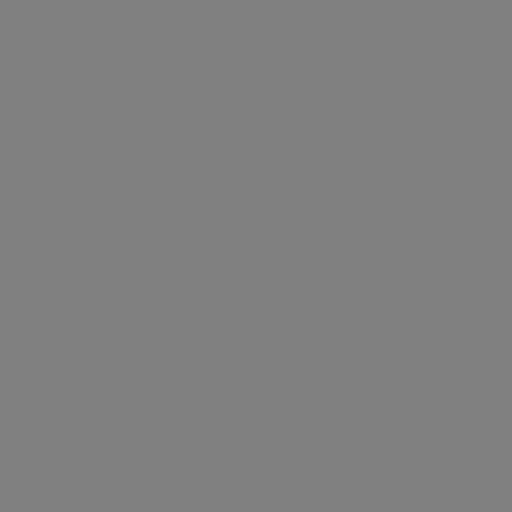

In [1003]:
c_512 = 1*color_512

In [1004]:
typeof(c_512)

Matrix{RGB{Float32}} (alias for Array{RGB{Float32}, 2})

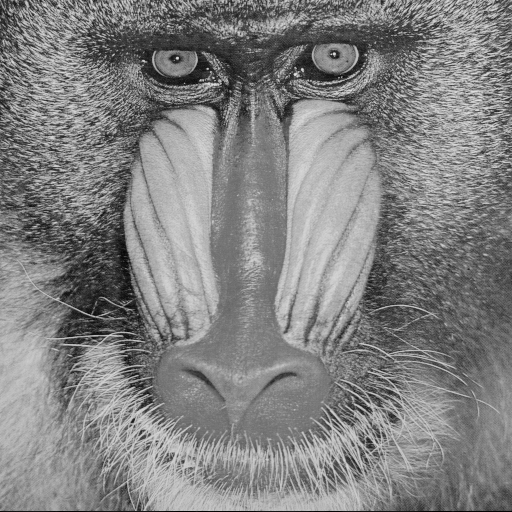

In [1009]:
channelview(c_512)[1,:,:] = im0

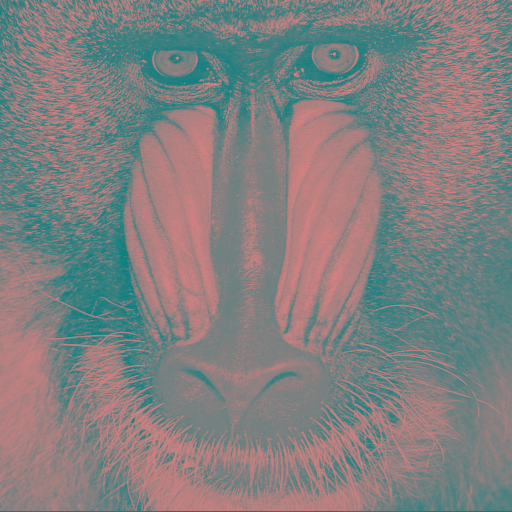

In [1010]:
c_512

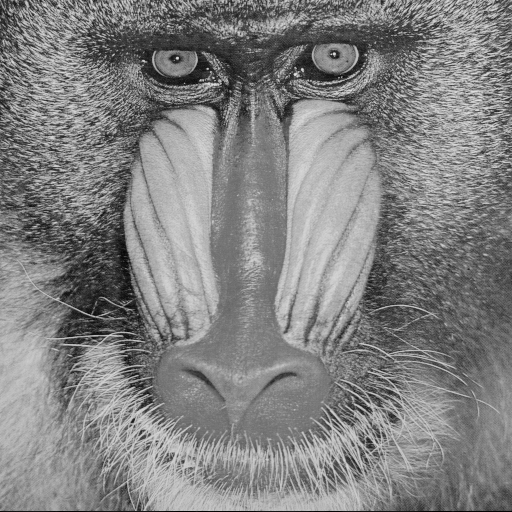

In [1011]:
channelview(c_512)[2,:,:] = im0

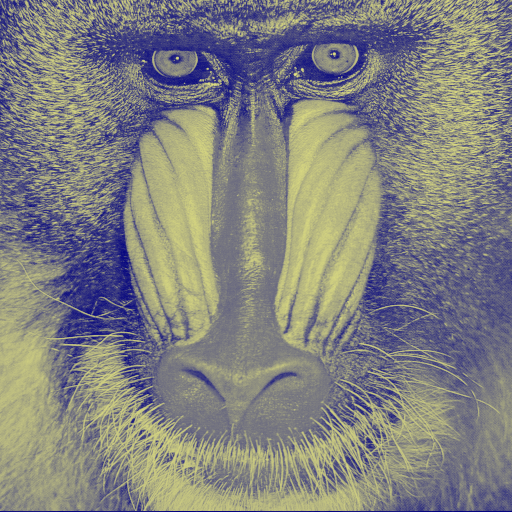

In [1012]:
c_512

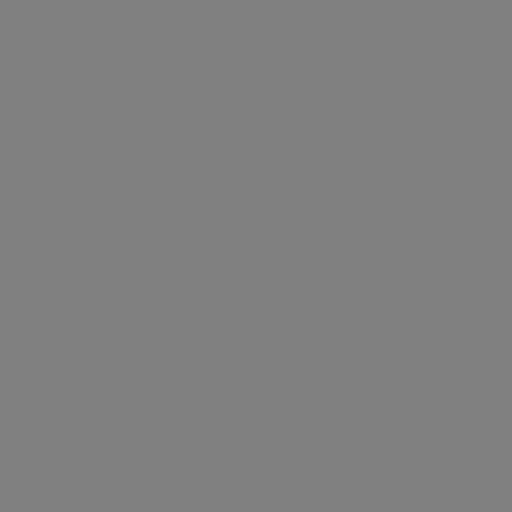

In [1015]:
c_513 = 1*color_512

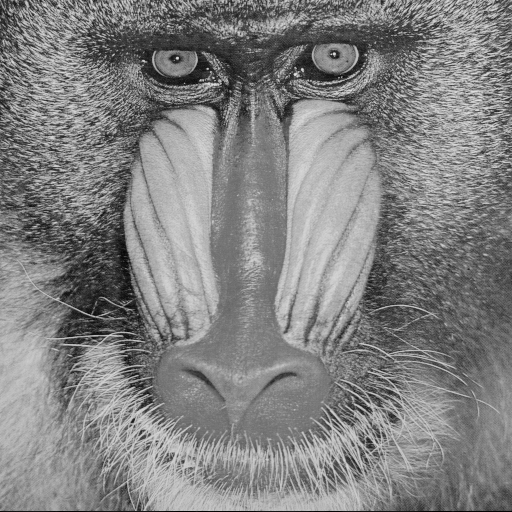

In [1016]:
channelview(c_513)[2,:,:] = im0

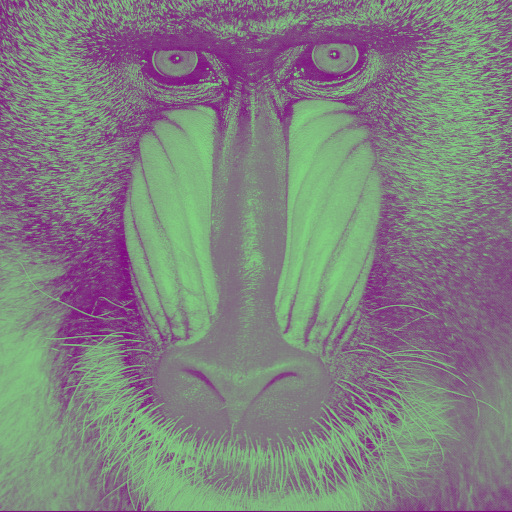

In [1017]:
c_513

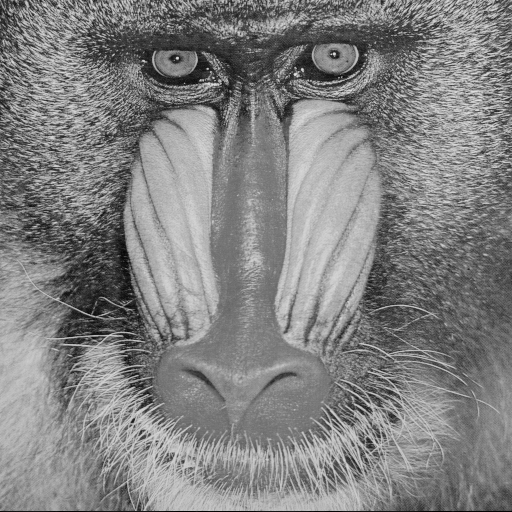

In [1018]:
channelview(c_513)[3,:,:] = im0

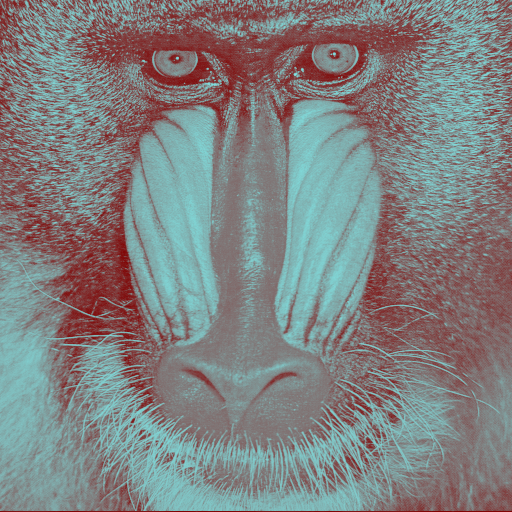

In [1019]:
c_513

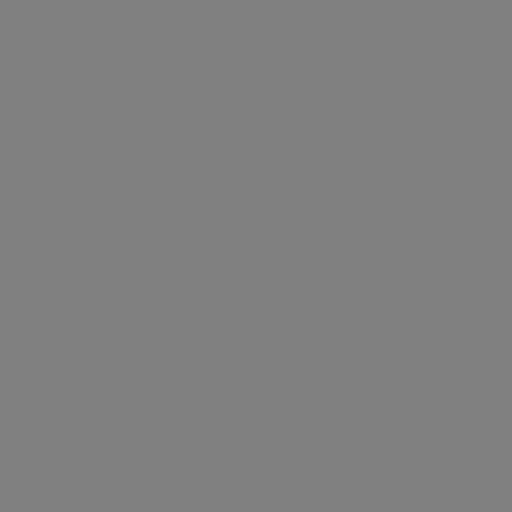

In [1020]:
c_514 = 1*color_512

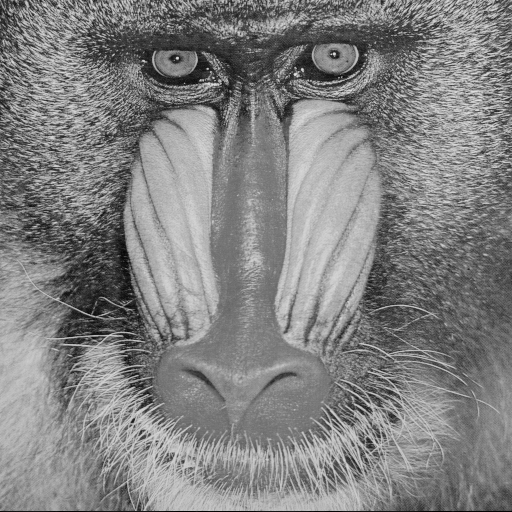

In [1021]:
channelview(c_514)[3,:,:] = im0

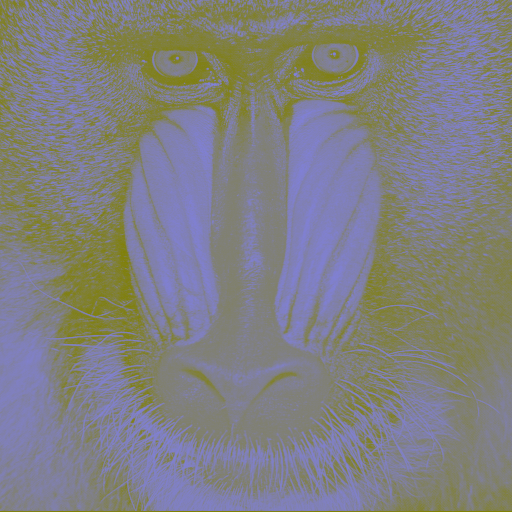

In [1022]:
c_514

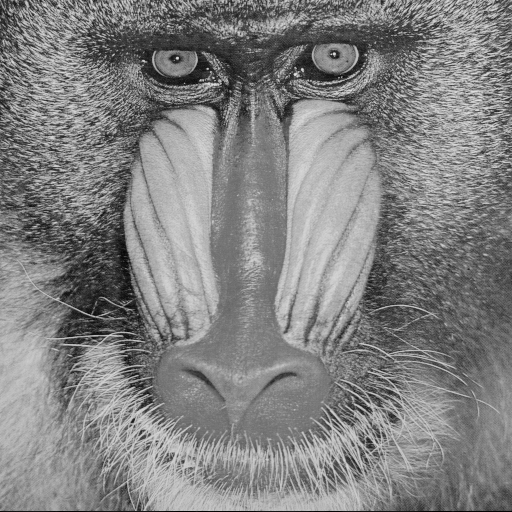

In [1023]:
channelview(c_514)[1,:,:] = im0

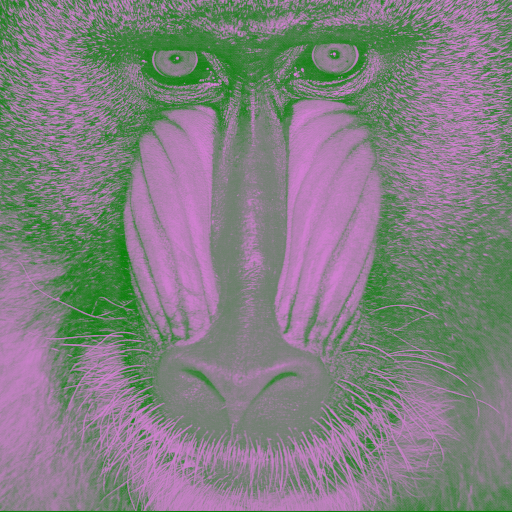

In [1024]:
c_514

In [1025]:
function gray_copy(color_image)
    result = deepcopy(color_image)
    result .= 0.5
end

gray_copy (generic function with 1 method)

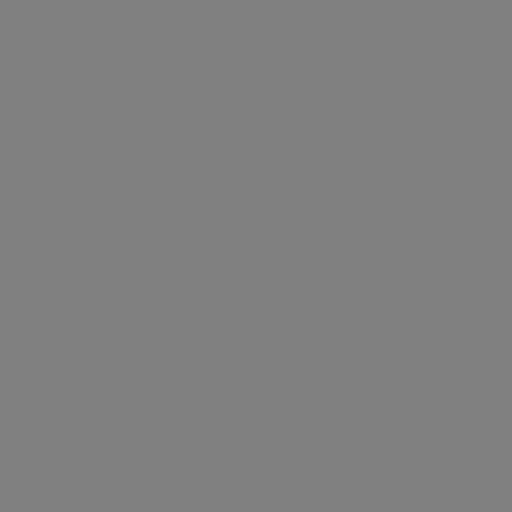

In [1026]:
new_gray = gray_copy(img)

In [1027]:
test_matrix = convert(Matrix{Float32}, im0)

512×512 Matrix{Float32}:
 0.568627   0.219608   0.192157   0.34902   …  0.443137  0.6        0.694118
 0.454902   0.396078   0.156863   0.262745     0.509804  0.584314   0.490196
 0.301961   0.447059   0.180392   0.180392     0.392157  0.345098   0.317647
 0.278431   0.533333   0.372549   0.188235     0.286275  0.294118   0.27451
 0.341176   0.478431   0.517647   0.196078     0.231373  0.313726   0.337255
 0.321569   0.298039   0.623529   0.239216  …  0.333333  0.596078   0.713726
 0.168627   0.2        0.52549    0.509804     0.72549   0.776471   0.643137
 0.129412   0.2        0.435294   0.6          0.631373  0.470588   0.541176
 0.223529   0.188235   0.219608   0.458824     0.529412  0.611765   0.478431
 0.14902    0.12549    0.188235   0.25098      0.254902  0.317647   0.533333
 0.129412   0.168627   0.223529   0.145098  …  0.254902  0.286275   0.266667
 0.129412   0.184314   0.305882   0.141176     0.34902   0.290196   0.294118
 0.141176   0.262745   0.352941   0.254902     0.301

In [1029]:
channelview(new_gray)[3,:,:] = test_matrix

512×512 Matrix{Float32}:
 0.568627   0.219608   0.192157   0.34902   …  0.443137  0.6        0.694118
 0.454902   0.396078   0.156863   0.262745     0.509804  0.584314   0.490196
 0.301961   0.447059   0.180392   0.180392     0.392157  0.345098   0.317647
 0.278431   0.533333   0.372549   0.188235     0.286275  0.294118   0.27451
 0.341176   0.478431   0.517647   0.196078     0.231373  0.313726   0.337255
 0.321569   0.298039   0.623529   0.239216  …  0.333333  0.596078   0.713726
 0.168627   0.2        0.52549    0.509804     0.72549   0.776471   0.643137
 0.129412   0.2        0.435294   0.6          0.631373  0.470588   0.541176
 0.223529   0.188235   0.219608   0.458824     0.529412  0.611765   0.478431
 0.14902    0.12549    0.188235   0.25098      0.254902  0.317647   0.533333
 0.129412   0.168627   0.223529   0.145098  …  0.254902  0.286275   0.266667
 0.129412   0.184314   0.305882   0.141176     0.34902   0.290196   0.294118
 0.141176   0.262745   0.352941   0.254902     0.301

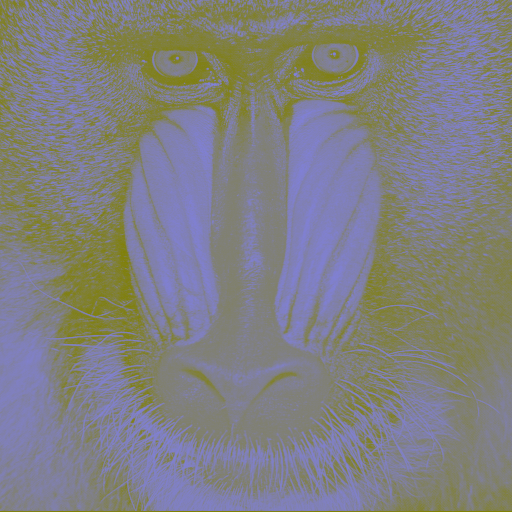

In [1030]:
new_gray

In [1031]:
# requires: using ImageCore
function fill_channels_3_1(color_image, gray_or_matrix)
    channelview(color_image)[3,:,:] = gray_or_matrix
    channelview(color_image)[1,:,:] = gray_or_matrix
    color_image
end 

fill_channels_3_1 (generic function with 1 method)

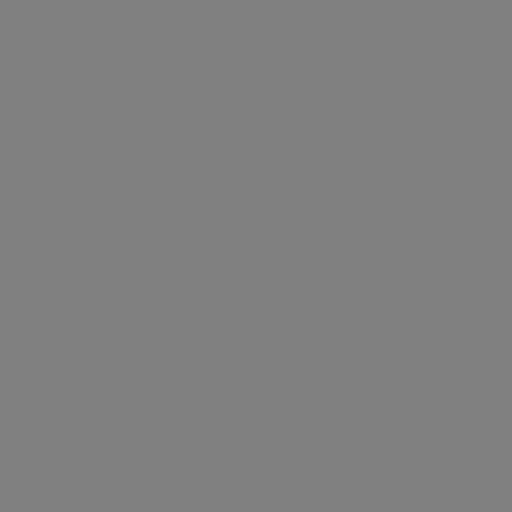

In [1032]:
new_gray = gray_copy(img)

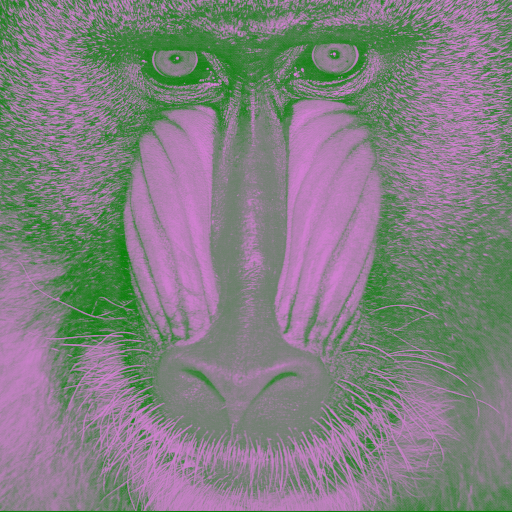

In [1033]:
fill_channels_3_1(new_gray, test_matrix)

In [1036]:
delta = m_im0 - im0

512×512 Matrix{Float32}:
 -0.00377136   0.0419273    -0.135718    …   0.113861     0.0969924
  0.0447446   -0.0826646    -0.157197        0.00643742   0.0462225
  0.0647578   -0.076171      0.108992        0.026003     0.10905
  0.11314     -0.0568781     0.111546        0.0881694    0.111408
  0.00370914  -0.0852242    -0.00424588      0.162324     0.095444
  0.0674475    0.0946498    -0.167312    …  -0.0396541   -0.0594784
  0.168585     0.178375     -0.0602368      -0.171815    -0.135475
  0.196626     0.137998     -0.088221       -0.0208361   -0.0598915
  0.198148     0.0720802     0.0964208       0.0780897    0.00457692
  0.190113     0.160197      0.18122         0.1301       0.089865
  0.169228     0.138326      0.0307846   …   0.145728     0.11514
  0.151143     0.0975428     0.0762857       0.114452     0.0727177
  0.0675324    0.107918      0.135305        0.0524155    0.113905
  ⋮                                      ⋱   ⋮           
 -0.0578552    0.0456025    -0.0119199   

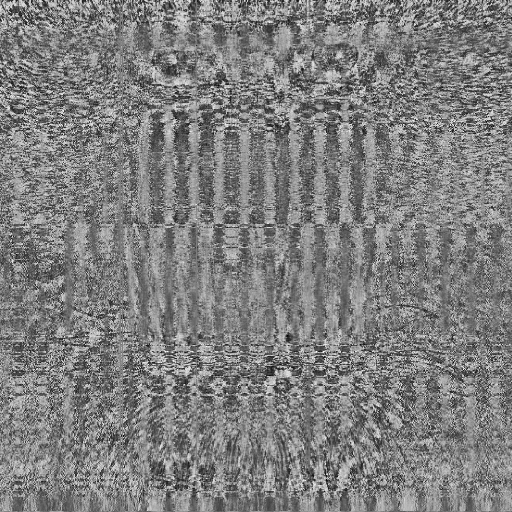

In [1038]:
Gray.(normalize_image(delta))

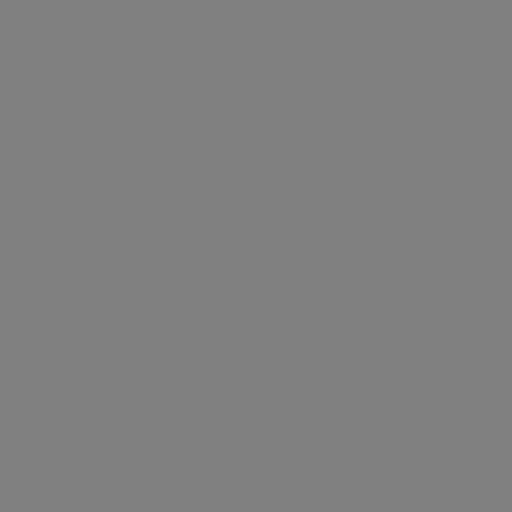

In [1039]:
new_gray_1 = gray_copy(img)

In [1040]:
channelview(new_gray_1)[3,:,:] += delta

512×512 Matrix{Float32}:
 0.498189  0.543888  0.366243  0.450584  …  0.388111  0.615822  0.598953
 0.546705  0.419296  0.344764  0.622693     0.475782  0.508398  0.548183
 0.566719  0.42579   0.610953  0.656476     0.496045  0.527964  0.611011
 0.615101  0.445083  0.613506  0.565295     0.622788  0.59013   0.613369
 0.50567   0.416737  0.497715  0.627339     0.635554  0.664284  0.597405
 0.569408  0.596611  0.334648  0.616446  …  0.466915  0.462307  0.442482
 0.670546  0.680336  0.441724  0.469679     0.396897  0.330145  0.366485
 0.698587  0.639959  0.41374   0.314354     0.385862  0.481125  0.442069
 0.700109  0.574041  0.598382  0.405541     0.495332  0.58005   0.506538
 0.692074  0.662158  0.683181  0.522859     0.58264   0.63206   0.591826
 0.671189  0.640287  0.532745  0.638904  …  0.463181  0.647688  0.617101
 0.653103  0.599504  0.578246  0.594529     0.554768  0.616413  0.574679
 0.569493  0.609879  0.637265  0.624566     0.48154   0.554376  0.615866
 ⋮                        

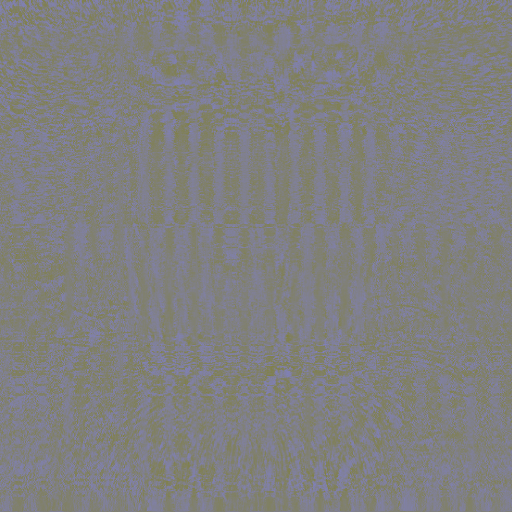

In [1041]:
new_gray_1

In [1042]:
channelview(new_gray_1)[1,:,:] += delta

512×512 Matrix{Float32}:
 0.498189  0.543888  0.366243  0.450584  …  0.388111  0.615822  0.598953
 0.546705  0.419296  0.344764  0.622693     0.475782  0.508398  0.548183
 0.566719  0.42579   0.610953  0.656476     0.496045  0.527964  0.611011
 0.615101  0.445083  0.613506  0.565295     0.622788  0.59013   0.613369
 0.50567   0.416737  0.497715  0.627339     0.635554  0.664284  0.597405
 0.569408  0.596611  0.334648  0.616446  …  0.466915  0.462307  0.442482
 0.670546  0.680336  0.441724  0.469679     0.396897  0.330145  0.366485
 0.698587  0.639959  0.41374   0.314354     0.385862  0.481125  0.442069
 0.700109  0.574041  0.598382  0.405541     0.495332  0.58005   0.506538
 0.692074  0.662158  0.683181  0.522859     0.58264   0.63206   0.591826
 0.671189  0.640287  0.532745  0.638904  …  0.463181  0.647688  0.617101
 0.653103  0.599504  0.578246  0.594529     0.554768  0.616413  0.574679
 0.569493  0.609879  0.637265  0.624566     0.48154   0.554376  0.615866
 ⋮                        

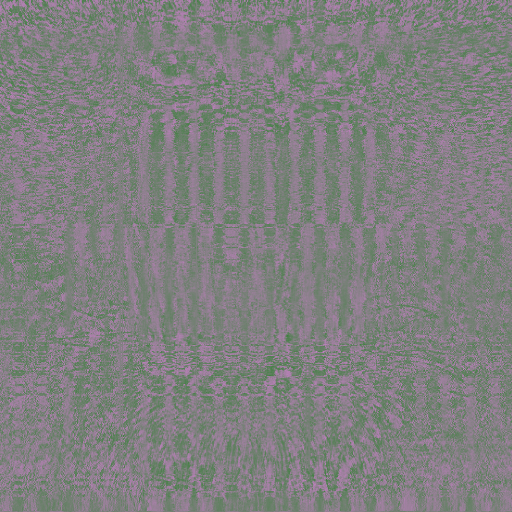

In [1043]:
new_gray_1

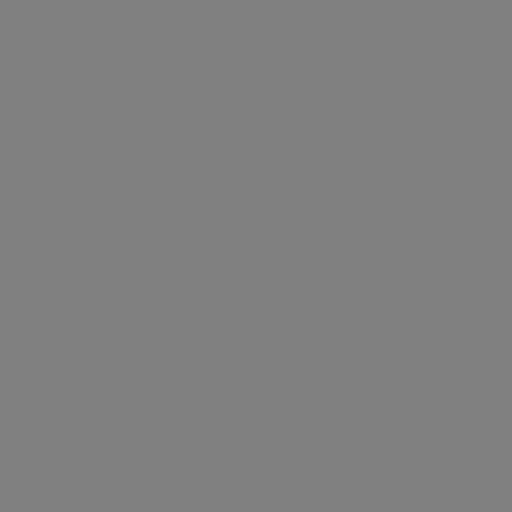

In [1044]:
new_gray_2 = gray_copy(img)

In [1046]:
typeof(new_gray_2)

Matrix{RGB{N0f8}} (alias for Array{RGB{Normed{UInt8, 8}}, 2})

In [1060]:
function monochrome_copy(color_image)
    result = deepcopy(color_image)
    gray_layer = Gray.(color_image)
    channelview(result)[1,:,:] = gray_layer
    channelview(result)[2,:,:] = gray_layer
    channelview(result)[3,:,:] = gray_layer
    result
end

monochrome_copy (generic function with 1 method)

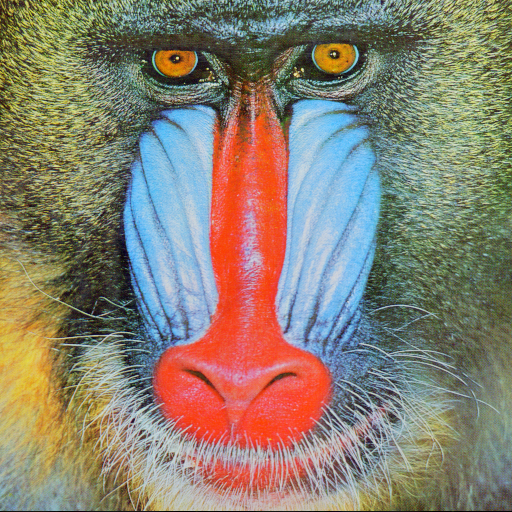

In [1054]:
test = deepcopy(img)

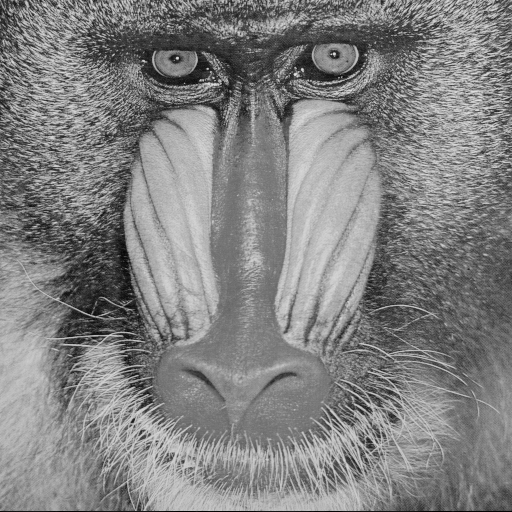

In [1055]:
channelview(test)[1,:,:] = Gray.(test)

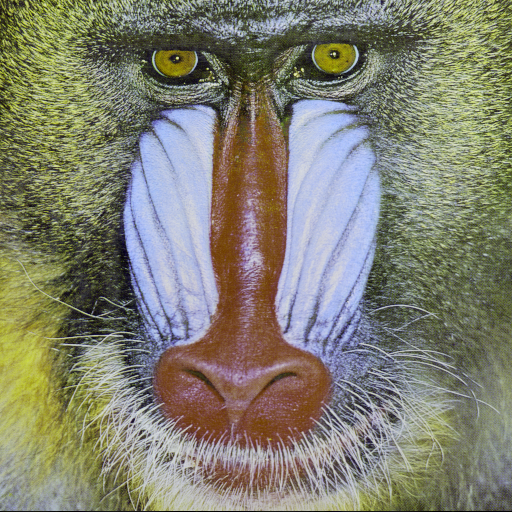

In [1056]:
test

In [1059]:
typeof(test)

Matrix{RGB{N0f8}} (alias for Array{RGB{Normed{UInt8, 8}}, 2})

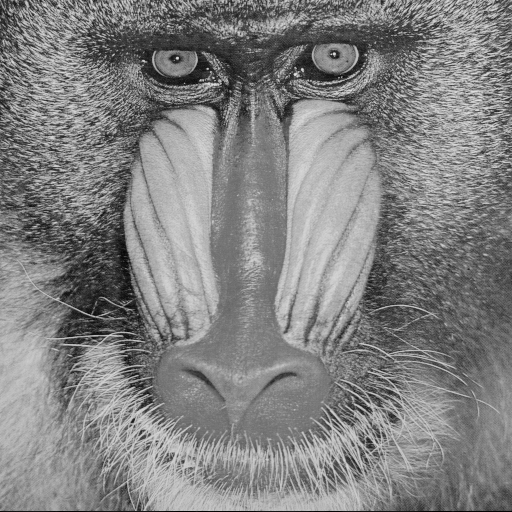

In [1064]:
monochrome_img = 1*monochrome_copy(img)

In [1049]:
# requires: using ImageCore
function add_to_channels_3_1(color_image, gray_or_matrix)
    channelview(color_image)[3,:,:] += gray_or_matrix
    channelview(color_image)[1,:,:] += gray_or_matrix
    color_image
end 

add_to_channels_3_1 (generic function with 1 method)

In [1065]:
typeof(monochrome_img)

Matrix{RGB{Float32}} (alias for Array{RGB{Float32}, 2})

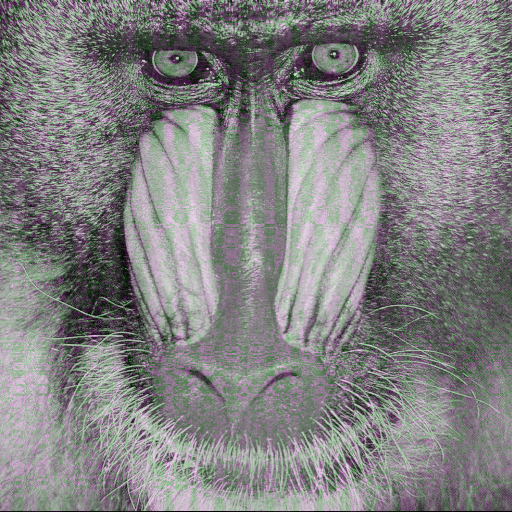

In [1066]:
add_to_channels_3_1(monochrome_img, delta)

In [1067]:
delta_warped = m_im0_warped - im0

512×512 Matrix{Float64}:
  0.0          0.0         0.0          …   0.0          0.0
  0.113726    -0.176471    0.0352941        0.0156863    0.203922
  0.266667    -0.227451    0.0117647        0.254902     0.376471
  0.230381    -0.313726   -0.180392         0.305882     0.419608
  0.0332845   -0.258824   -0.32549          0.286275     0.356863
 -0.0319834   -0.0421235  -0.431373     …   0.00392157  -0.0196078
  0.142805     0.206567   -0.333333        -0.176471     0.0509804
  0.201452     0.264809   -0.249618         0.129412     0.152941
  0.0175982    0.333802   -0.0584248       -0.0117647    0.0546651
 -0.00101806   0.315826    0.0274392        0.277655    -0.179386
  0.0495022    0.109241    0.175661     …   0.226388     0.0169182
  0.0549284    0.0156863   0.231206         0.0396321    0.0299371
 -0.00246981  -0.0651656   0.252587        -0.0725583    0.230603
  ⋮                                     ⋱   ⋮           
 -0.0866817   -0.0255937   0.0851557    …   0.0894379   -0.0

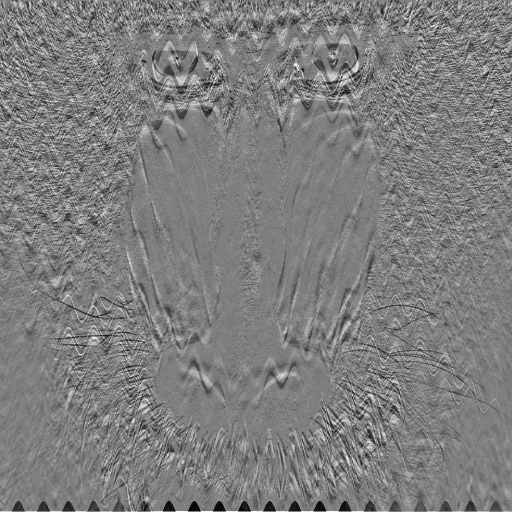

In [1068]:
Gray.(normalize_image(delta_warped))

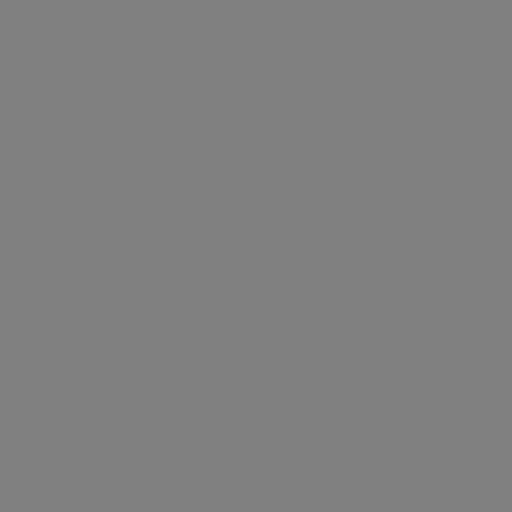

In [1069]:
new_gray_2

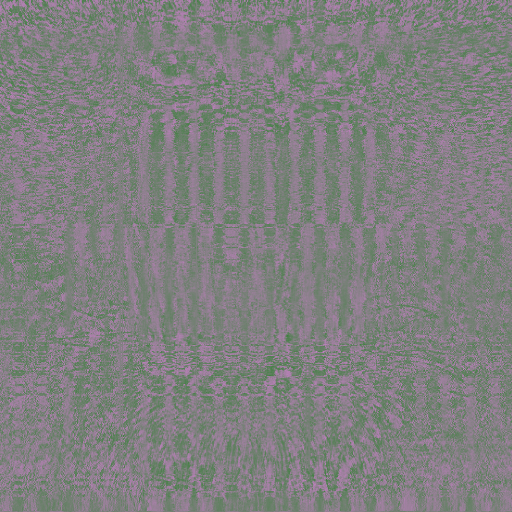

In [1071]:
add_to_channels_3_1(new_gray_2, delta)

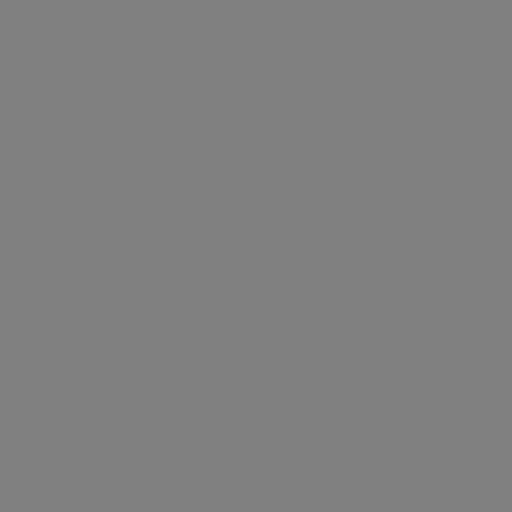

In [1074]:
new_gray_3 = 1*gray_copy(img)

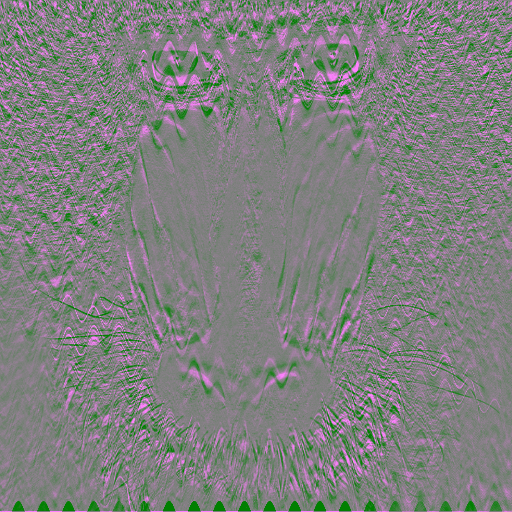

In [1075]:
add_to_channels_3_1(new_gray_3, delta_warped)

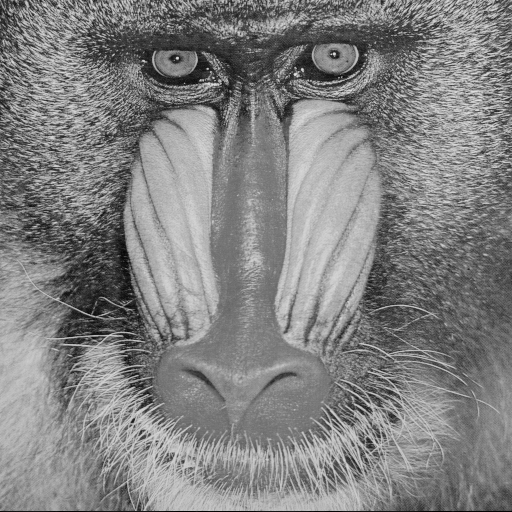

In [1076]:
monochrome_img_2 = 1*monochrome_copy(img)

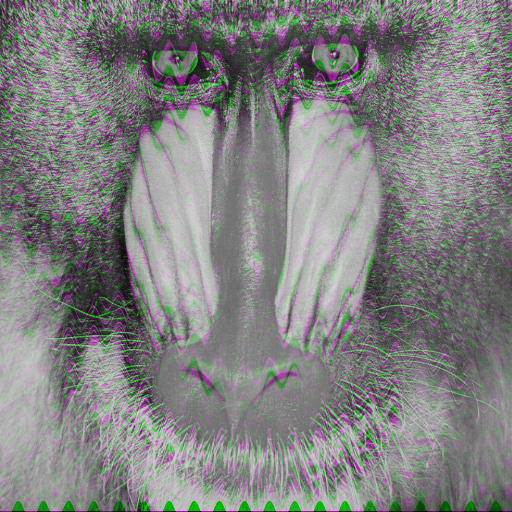

In [1078]:
add_to_channels_3_1(monochrome_img_2, delta_warped)

In [1079]:
delta_warped_learned = m_im0_warped - m_im0

512×512 Matrix{Float64}:
  0.00377136  -0.0419273   0.135718   …  -0.113861    -0.0969924
  0.068981    -0.093806    0.192491       0.00924885   0.157699
  0.201909    -0.15128    -0.0972272      0.228899     0.267421
  0.117241    -0.256847   -0.291938       0.217713     0.3082
  0.0295753   -0.173599   -0.321244       0.123951     0.261419
 -0.0994309   -0.136773   -0.26406    …   0.0435757    0.0398706
 -0.0257797    0.0281925  -0.273097      -0.00465518   0.186456
  0.00482589   0.126812   -0.161397       0.150248     0.212833
 -0.18055      0.261722   -0.154846      -0.0898544    0.0500882
 -0.191131     0.15563    -0.15378        0.147555    -0.269251
 -0.119726    -0.0290851   0.144877   …   0.0806607   -0.0982215
 -0.0962142   -0.0818565   0.15492       -0.0748197   -0.0427806
 -0.0700022   -0.173084    0.117282      -0.124974     0.116698
  ⋮                                   ⋱   ⋮           
 -0.0288265   -0.0711962   0.0970756  …  -0.00058642  -0.0814578
  0.061395    -0.085

In [1080]:
delta_learned_warped = m_im0 - m_im0_warped

512×512 Matrix{Float64}:
 -0.00377136   0.0419273  -0.135718   …   0.113861     0.0969924
 -0.068981     0.093806   -0.192491      -0.00924885  -0.157699
 -0.201909     0.15128     0.0972272     -0.228899    -0.267421
 -0.117241     0.256847    0.291938      -0.217713    -0.3082
 -0.0295753    0.173599    0.321244      -0.123951    -0.261419
  0.0994309    0.136773    0.26406    …  -0.0435757   -0.0398706
  0.0257797   -0.0281925   0.273097       0.00465518  -0.186456
 -0.00482589  -0.126812    0.161397      -0.150248    -0.212833
  0.18055     -0.261722    0.154846       0.0898544   -0.0500882
  0.191131    -0.15563     0.15378       -0.147555     0.269251
  0.119726     0.0290851  -0.144877   …  -0.0806607    0.0982215
  0.0962142    0.0818565  -0.15492        0.0748197    0.0427806
  0.0700022    0.173084   -0.117282       0.124974    -0.116698
  ⋮                                   ⋱   ⋮           
  0.0288265    0.0711962  -0.0970756  …   0.00058642   0.0814578
 -0.061395     0.085

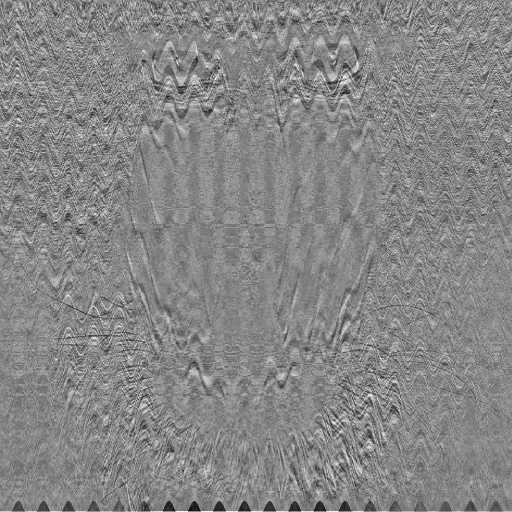

In [1081]:
Gray.(normalize_image(delta_warped_learned))

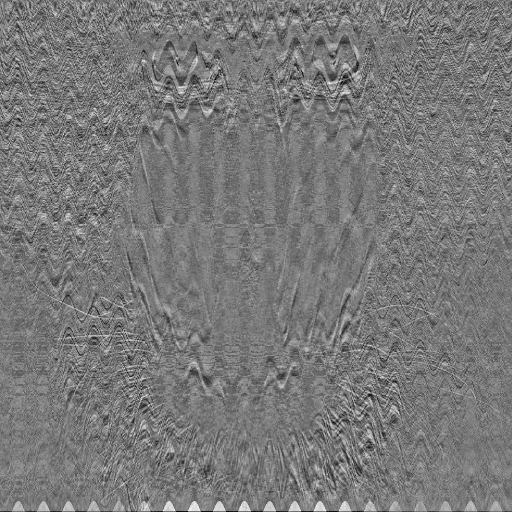

In [1082]:
Gray.(normalize_image(delta_learned_warped))

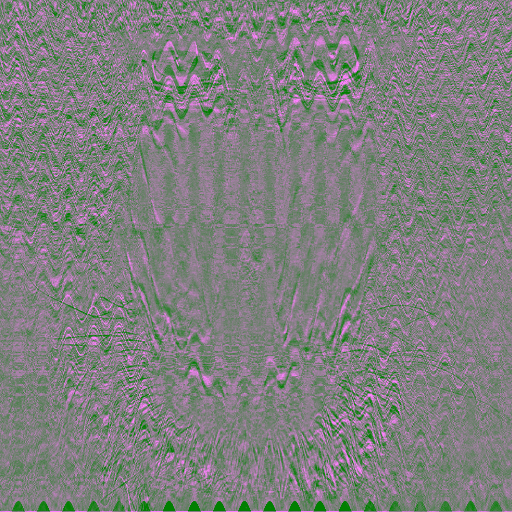

In [1083]:
new_gray_4 = 1*gray_copy(img)
new_gray_5 = 1*gray_copy(img)
add_to_channels_3_1(new_gray_4, delta_warped_learned)

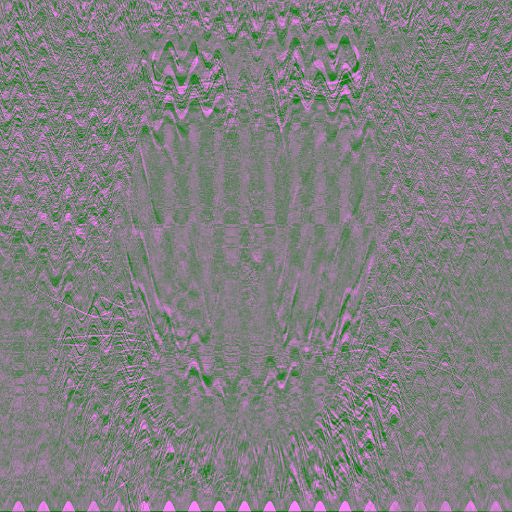

In [1084]:
add_to_channels_3_1(new_gray_5, delta_learned_warped)

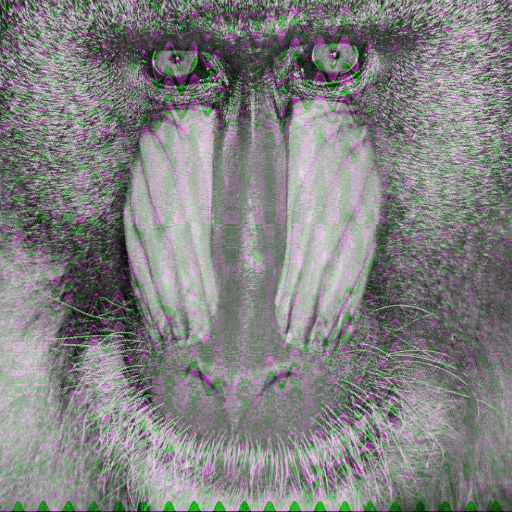

In [1085]:
monochrome_img_4 = 1*monochrome_copy(img)
monochrome_img_5 = 1*monochrome_copy(img)
add_to_channels_3_1(monochrome_img_4, delta_warped_learned)

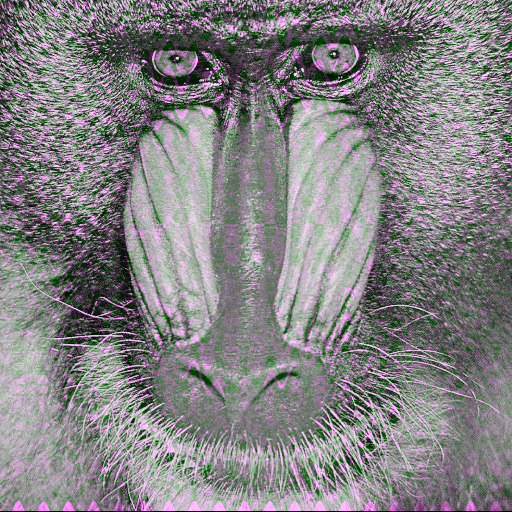

In [1086]:
add_to_channels_3_1(monochrome_img_5, delta_learned_warped)

In [1087]:
delta_product = m_im0_warped_norm - p_m_im0_norm

512×512 Matrix{Float64}:
 -0.104723    -0.390046   -0.352356   …   0.262979    0.428694    0.520039
 -0.0537817   -0.461538   -0.425344       0.274765    0.442334    0.532516
  0.0134148   -0.395837   -0.475735       0.271571    0.437741    0.52839
 -0.00267841  -0.320273   -0.405968       0.262593    0.43477     0.528368
 -0.137365    -0.309462   -0.344165       0.270293    0.437004    0.529894
 -0.213342    -0.267529   -0.330786   …   0.26382     0.444669    0.540834
 -0.212122    -0.131967   -0.319046       0.272017    0.453418    0.551471
 -0.169745    -0.0590518  -0.316092       0.289287    0.463936    0.552721
 -0.228802     0.0348122  -0.310751       0.297956    0.463879    0.382858
 -0.315718    -0.0301311  -0.245274       0.30113     0.44583     0.180376
 -0.294086    -0.196843   -0.0699364  …   0.311441    0.341811    0.0967563
 -0.29383     -0.288711    0.051168       0.304696    0.165576    0.157041
 -0.316616    -0.271541    0.130775       0.18844     0.138057    0.482159


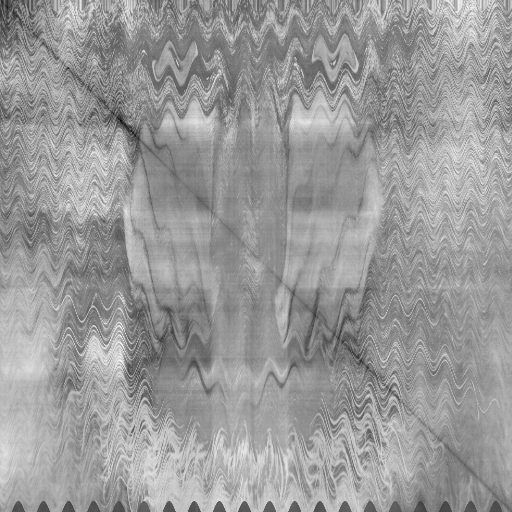

In [1090]:
Gray.(normalize_image(delta_product)) 
# this is obviously wrong, because delta_product is wrong
# but it is cute!!!

In [1091]:
delta_product_correct = p_m_im0_warped_norm - p_m_im0_norm

512×512 Matrix{Float64}:
 -0.0308549   -0.0646897    -0.0098549   …  -0.00525452    0.00431334
 -0.0646897   -0.00385482   -0.0593216       0.00188974    0.00723335
 -0.0098549   -0.0593216     0.0055492      -0.0048362    -0.00582783
  0.0131165   -0.000873908  -0.059099        0.00378676   -0.00556885
  0.00812572  -0.00430512   -0.00885285      0.012014      0.0149712
  0.0105879    0.00607074    0.0154689   …   0.00982918    0.0218349
  0.00783721   0.0119755     0.0460802       0.00837572    0.0263255
  0.0138058    0.0343261     0.0497198       0.000704492   0.0144707
  0.0148081    0.0529627     0.0358548       0.00217984    0.00539238
  0.00717804   0.0399952     0.0300785       0.000854133  -0.0171052
  0.00571104   0.0129152     0.0270007   …  -0.0178699    -0.0165388
  0.00672246   0.00416406    0.0266633      -0.0142149    -0.00358657
  0.00950282   0.0112647     0.00680754     -0.00749545    0.000404642
  ⋮                                      ⋱   ⋮            
  0.0277766

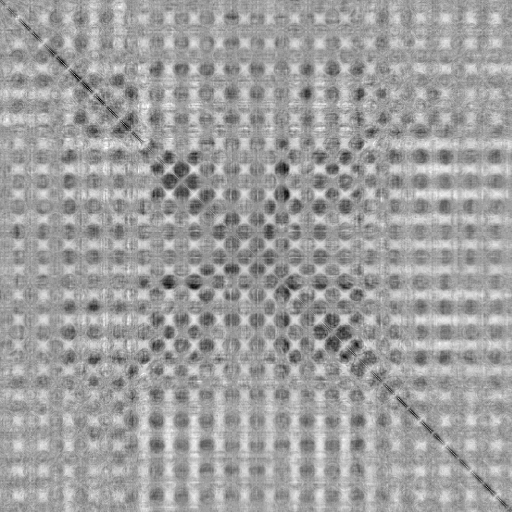

In [1092]:
Gray.(normalize_image(delta_product_correct)) 

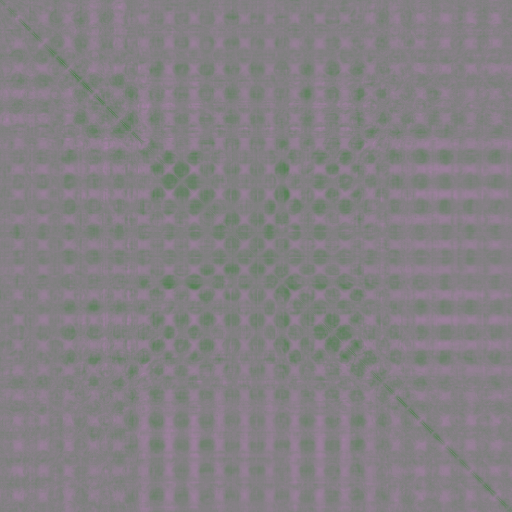

In [1093]:
new_gray_6 = 1*gray_copy(img)
add_to_channels_3_1(new_gray_6, delta_product_correct)

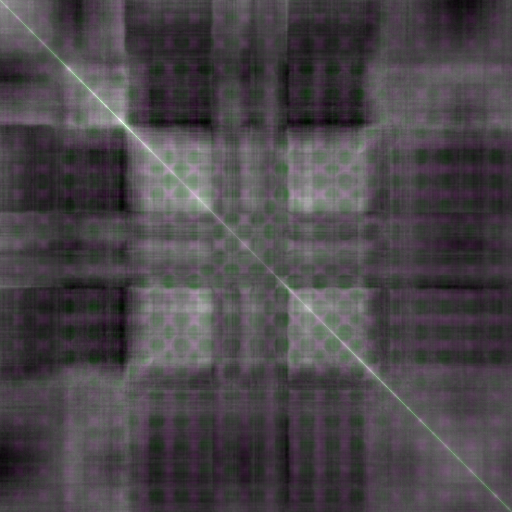

In [1097]:
monochrome_img_6 = 1*gray_copy(img)
channelview(monochrome_img_6)[1,:,:] = p_m_im0_norm
channelview(monochrome_img_6)[2,:,:] = p_m_im0_norm
channelview(monochrome_img_6)[3,:,:] = p_m_im0_norm
add_to_channels_3_1(monochrome_img_6, delta_product_correct)

In [1098]:
function colored_animation_frame(i)
    delta_i = large_ms[i] - im0
    left_i = 1*monochrome_copy(img)
    add_to_channels_3_1(left_i, delta_i)
    delta_product_i = value3(large_ms[i]) - p_m_im0_norm
    right_i = 1*gray_copy(img)
    channelview(right_i)[1,:,:] = p_m_im0_norm
    channelview(right_i)[2,:,:] = p_m_im0_norm
    channelview(right_i)[3,:,:] = p_m_im0_norm
    add_to_channels_3_1(right_i, delta_product_i)
    hcat(left_i, right_i)
end

colored_animation_frame (generic function with 1 method)

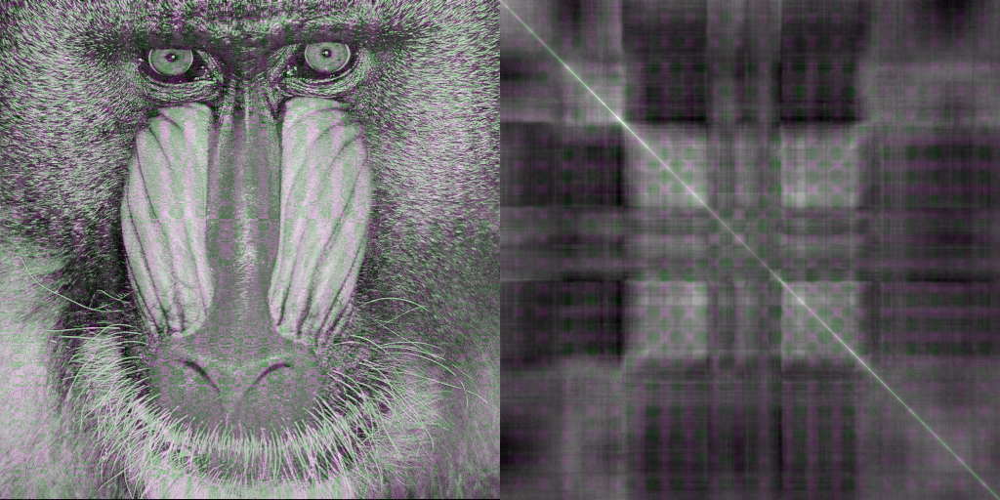

In [1100]:
colored_animation_frame(227)

,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,

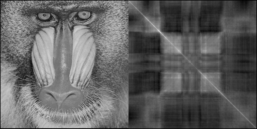
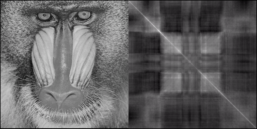
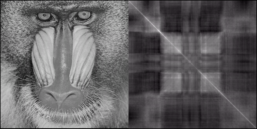
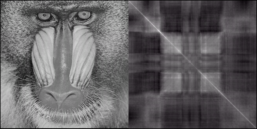
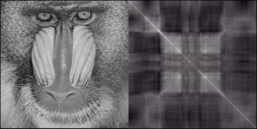
...
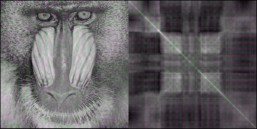
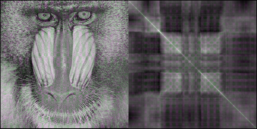
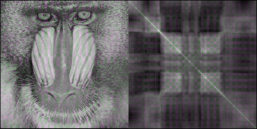
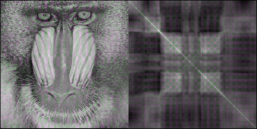
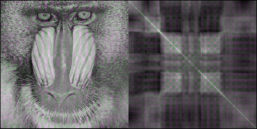

In [1103]:
colored_animation_frames = [colored_animation_frame(i) for i in 1:length(large_ms)] 

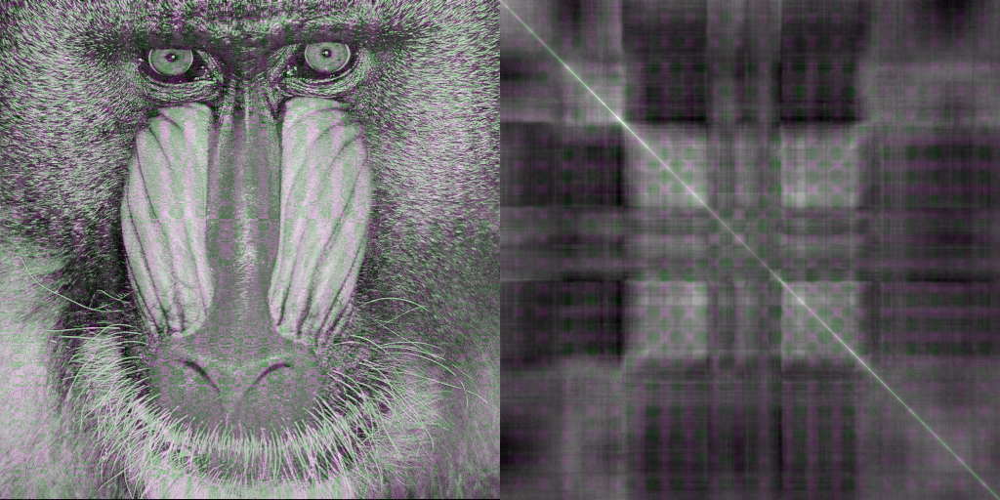

In [1106]:
z = deepcopy(colored_animation_frames[227])

In [1118]:
function clip_float_color_frame(frame)
    channelview(frame)[1,:,:] = clip_float.(channelview(frame)[1,:,:])
    channelview(frame)[2,:,:] = clip_float.(channelview(frame)[2,:,:])
    channelview(frame)[3,:,:] = clip_float.(channelview(frame)[3,:,:])
    frame
end

clip_float_color_frame (generic function with 1 method)

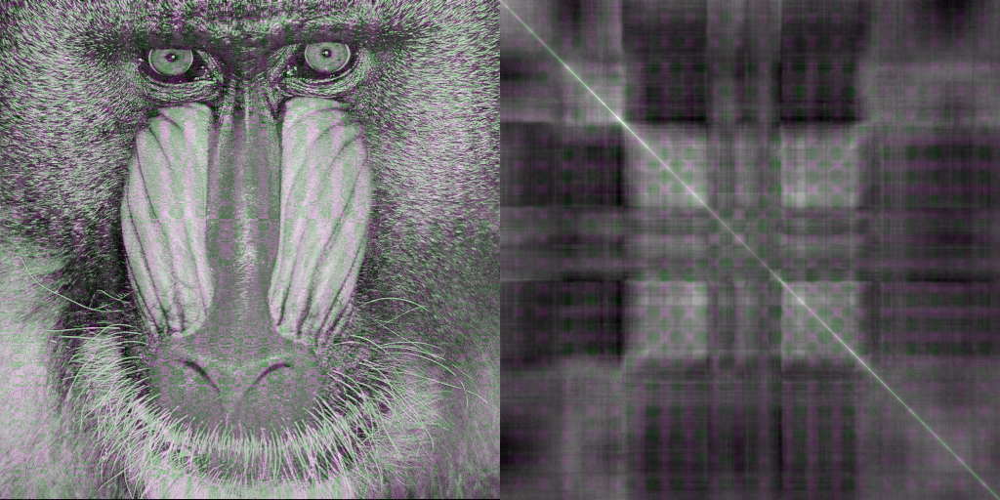

In [1119]:
clip_float_color_frame(z)

In [1121]:
minimum(channelview(z)[1,:,:])

0.0f0

In [1122]:
colored_imgs = []
for i in 1:6:length(colored_animation_frames)
    push!(colored_imgs, clip_float_color_frame(colored_animation_frames[i]))
end

save("learning-may-23_step6_fps1_colored.gif", cat(colored_imgs..., dims=3), fps=1)